# Install Required Packages

The following command installs the necessary Python packages `ultralytics`, `gradio`, and `gdown` using pip. These packages are essential for the project's functionalities related to object detection, interactive UI development, and downloading files within the Colab environment.

In [ ]:
!pip install ultralytics gradio gdown

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.8/882.8 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 24.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.6/94.6 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.0/78.0 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 41.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.5/71.5 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/1

# Importing Necessary Libraries

In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import numpy as np
import time
from IPython.display import Image, display
from google.colab.patches import cv2_imshow
import requests
import os
import zipfile
import gdown
import gradio as gr
import pandas as pd
from huggingface_hub import hf_hub_download

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Loading the Dataset:  Vehicles Object Detection by Roboflow
- Images: 4058
- Dataset: 2
- Classes (3):
 - bus
 - car
 - truck

 https://universe.roboflow.com/roboflow-100/vehicles-q0x2v/browse?queryText=&pageSize=50&startingIndex=50&browseQuery=true

In [ ]:
#!pip install roboflow

#from roboflow import Roboflow
#rf = Roboflow(api_key="ppt54ykY3mOZgt8NQt0x")
#project = rf.workspace("may-ee2la").project("vehicles-q0x2v-8kns4")
#version = project.version(1)
#dataset = version.download("yolov9")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.6 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to vehicles-1 in yolov9:: 100%|██████████| 8128/8128 [00:01<00:00, 6250.33it/s]


# Load the YOLO Model

## Train the model without Fine-tunning

In [ ]:
#!yolo task=detect mode=train model=yolov9s.pt data={dataset.location}/data.yaml epochs=50 imgsz=600

100% 14.7M/14.7M [00:00<00:00, 138MB/s]
Ultralytics YOLOv8.2.90 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov9s.pt, data=/content/vehicles-2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=600, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fa

## Train the model without Fine-tunning

In [ ]:
#!yolo task=detect mode=train model=yolov9s.pt \
#data={dataset.location}/data.yaml \
#epochs=50 \
#imgsz=600 \
#batch=8 \
#lr0=0.001 \
#lrf=0.1 \
#freeze=10

Ultralytics YOLOv8.2.100 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov9s.pt, data=/content/vehicles-1/data.yaml, epochs=50, time=None, patience=100, batch=8, imgsz=600, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show

In [ ]:
#!zip -r /content/capstone_train_finetuning.zip /content/runs/detect/train

  adding: content/runs/detect/train/ (stored 0%)
  adding: content/runs/detect/train/results.csv (deflated 85%)
  adding: content/runs/detect/train/val_batch0_pred.jpg (deflated 11%)
  adding: content/runs/detect/train/train_batch2.jpg (deflated 6%)
  adding: content/runs/detect/train/val_batch1_labels.jpg (deflated 12%)
  adding: content/runs/detect/train/args.yaml (deflated 52%)
  adding: content/runs/detect/train/R_curve.png (deflated 11%)
  adding: content/runs/detect/train/PR_curve.png (deflated 11%)
  adding: content/runs/detect/train/confusion_matrix_normalized.png (deflated 29%)
  adding: content/runs/detect/train/train_batch13201.jpg (deflated 17%)
  adding: content/runs/detect/train/train_batch13200.jpg (deflated 7%)
  adding: content/runs/detect/train/val_batch0_labels.jpg (deflated 12%)
  adding: content/runs/detect/train/val_batch2_labels.jpg (deflated 9%)
  adding: content/runs/detect/train/F1_curve.png (deflated 11%)
  adding: content/runs/detect/train/train_batch13202.j

## Download model from Hugging Face model repository
This section is responsible for downloading a model that we trained above and uploaded to the Hugging Face model repository using the hf_hub_download function. The hf_hub_download function is used to fetch the model checkpoint file (best.pt) associated with the repo ID "SaraSaud/vehicle-detection-yolov9".

After downloading the model checkpoint file to model_path, the code then loads this model using the YOLO class.

In [ ]:
#download model
model_path = hf_hub_download(repo_id="SaraSaud/vehicle-detection-yolov9", filename="best.pt")

#load model
model = YOLO(model_path)

best.pt:   0%|          | 0.00/15.2M [00:00<?, ?B/s]

# Model Evaluation

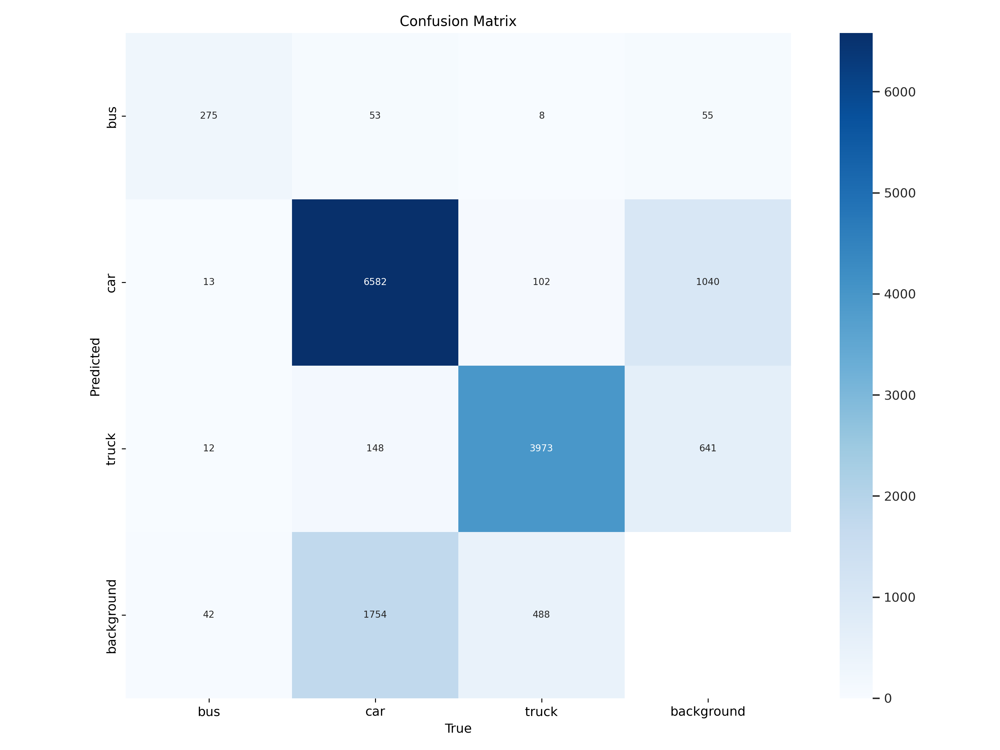

In [ ]:
Image(filename='/content/runs/detect/train/confusion_matrix.png', height=600)

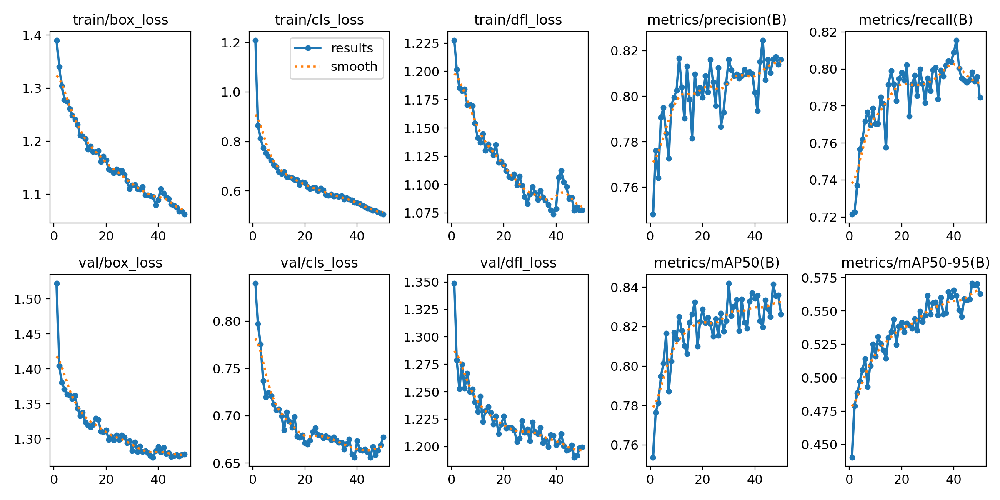

In [ ]:
Image(filename='/content/runs/detect/train/results.png', height=600)

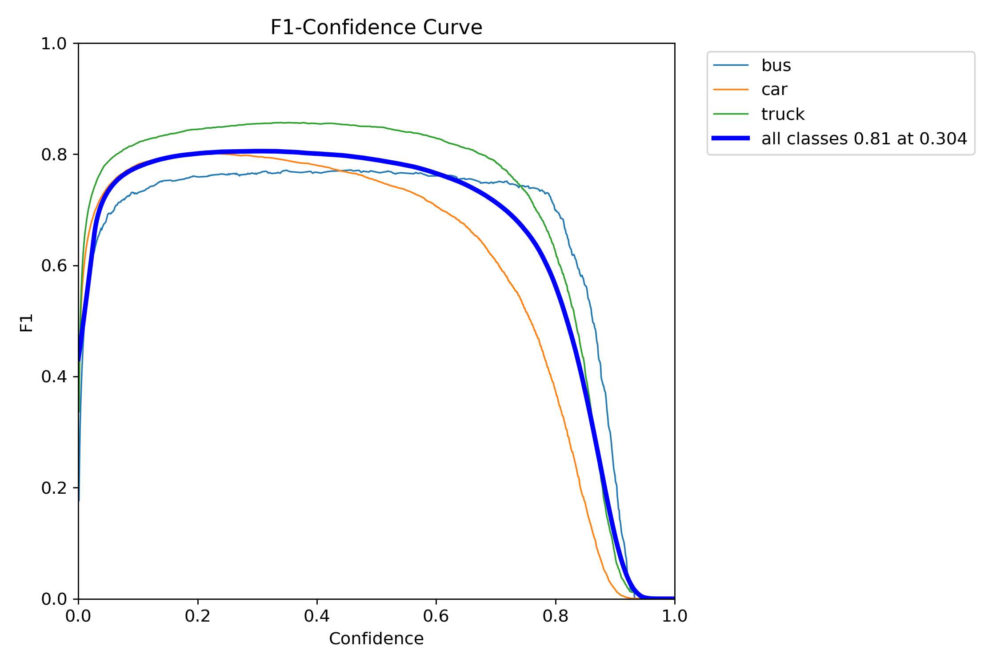

In [ ]:
Image(filename='/content/runs/detect/train/F1_curve.png', height=600)

# The input video

## Downloading the input video from Google Drive
https://drive.google.com/file/d/1uk82h66L1QE2XHx6NBwisxMVc37O8HDx/view

In [ ]:
file_id = '1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe'
url = f'https://drive.google.com/uc?id={file_id}'

output = 'input_video.mov'

gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe
From (redirected): https://drive.google.com/uc?id=1S5qMlRNeybqaWqntvcpLUjDnlgMB5ITe&confirm=t&uuid=8d5227a7-1dfa-4562-885e-63a4304a93bc
To: /content/input_video.mov
100%|██████████| 288M/288M [00:01<00:00, 167MB/s]


'input_video.mov'

## Prepare the Video Capture

In [ ]:
video_path = '/content/input_video.mov'
cap = cv2.VideoCapture(video_path)

## Get Video Information

In [ ]:
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

In [ ]:
print(width)
print(height)
print(fps)

3840
2160
59


# The output video

## Prepare Video Writer to Store the Output

In [ ]:
output_path = '/content/output_video.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

## Identify  `(x1, y1, x2, y2)` of the ROI

In [ ]:
ret, frame = cap.read()

result = model(frame)


0: 352x608 31 cars, 4 trucks, 101.0ms
Speed: 14.9ms preprocess, 101.0ms inference, 703.7ms postprocess per image at shape (1, 3, 352, 608)


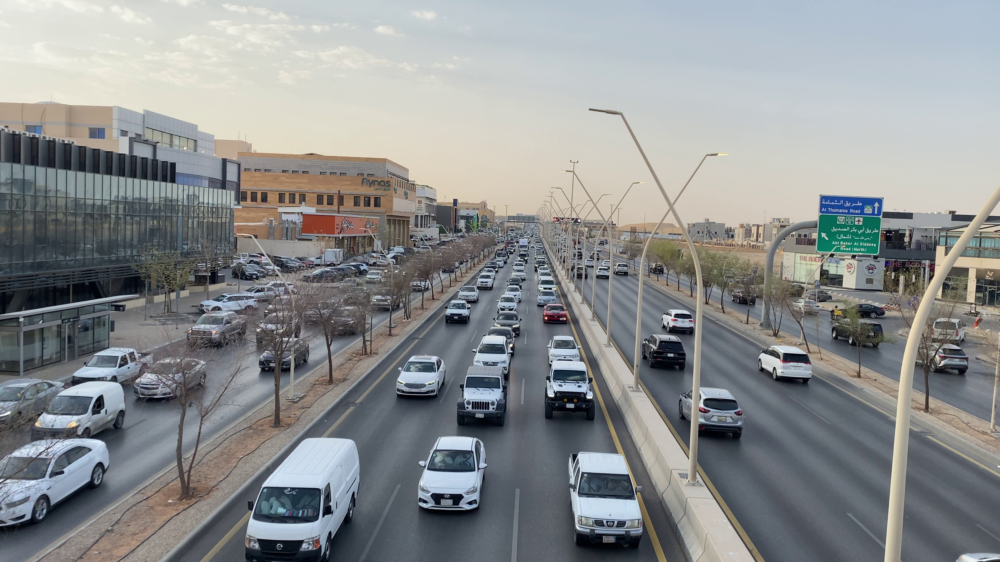

In [ ]:
cv2_imshow(frame)

In [ ]:
thickness = 3
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 0.8
font_thickness = 2
count_scale = 2
count_color = (255, 0, 0)
roi_color = (0, 255, 255)

ROI_POLYGON = np.array([[900, 1900], [2540, 1900], [2260, 1300], [1550, 1300]], dtype=np.int32)


class_colors = {
    'car': (51, 87, 255),  # Class 0 color: Orange
    'bus': (0, 64, 139),  # Class 1 color: Dark Orange
    'truck': (40, 140, 242)   # Class 2 color: Cadmium Orange
}

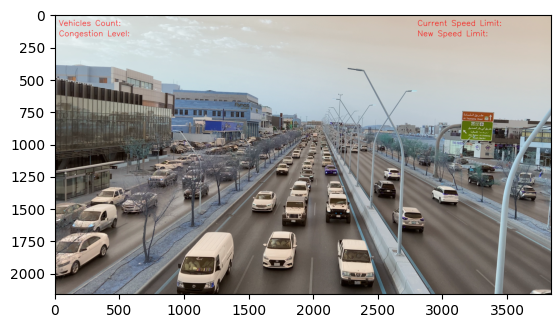

In [ ]:
cv2.putText(frame, 'Vehicles Count: ', (30, 90), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'Congestion Level: ', (30, 170), font, count_scale, count_color, font_thickness, cv2.LINE_AA)

cv2.putText(frame, 'Current Speed Limit: ', (2800, 90), font, count_scale, count_color, font_thickness, cv2.LINE_AA)
cv2.putText(frame, 'New Speed Limit: ', (2800, 170), font, count_scale, count_color, font_thickness, cv2.LINE_AA)

plt.imshow(frame)

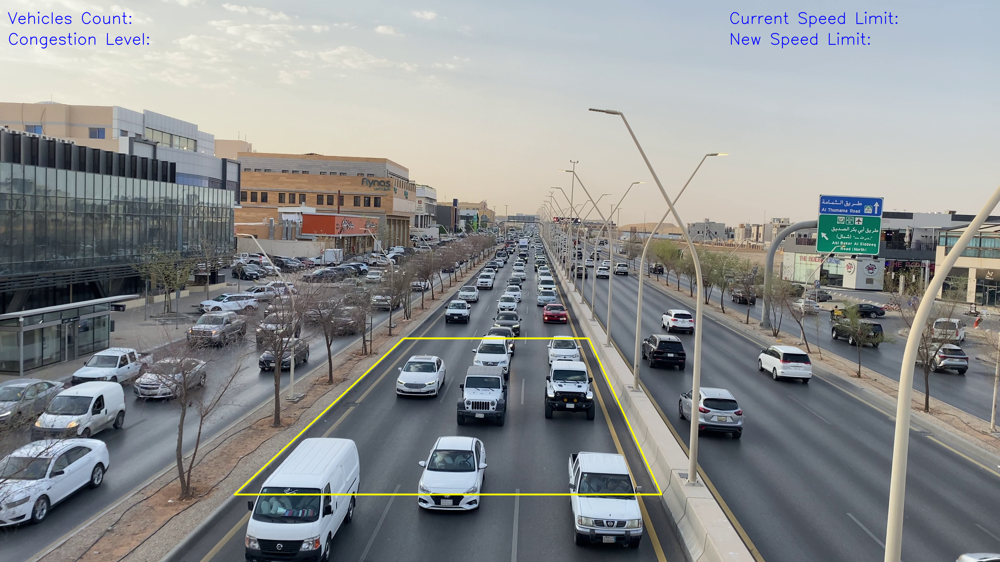

In [ ]:
frame_with_roi = cv2.polylines(frame, [ROI_POLYGON], isClosed=True, color=(0, 255, 255), thickness=5)

# Display the frame with the ROI polygon
cv2_imshow(frame_with_roi)

# Necessary Functions

## Determining Congestion Level Based on Time Spent in ROI

This function designed to assess congestion levels by analyzing the time objects spend in a specific Region of Interest (ROI). The function operates as follows:

1. **Thresholds Definition:**
   - `low_threshold`: Set at 4 units of time.
   - `heavy_threshold`: Set at 10 units of time.

2. **Function Description:**
   - **Input:** `obj_time_spent_in_roi` (a dictionary mapping objects to their respective time spent in the ROI).
   - **Output:** Returns the congestion level based on the average time spent in the ROI.

3. **Congestion Level Determination:**
   - If no vehicles are detected in the ROI, the congestion level is classified as "سالك" (Mild).
   - The function calculates the average time spent by objects in the ROI.
   - Based on the average time:
     - If the average time is less than or equal to the `low_threshold`, the congestion level is labeled as "سالك" (Mild).
     - If the average time falls between the `low_threshold` and `heavy_threshold`, the congestion level is classified as "زحام متوسط" (Moderate congestion).
     - For average times exceeding the `heavy_threshold`, the congestion level is denoted as "زحام شديد" (Heavy congestion).

In [ ]:
low_threshold = 4
heavy_threshold = 10

# Function to determine congestion level based on time spent in ROI
def determine_congestion_level(obj_time_spent_in_roi):

    # If no vehicles are detected, return the minimum level of congestion (Mild)
    if len(obj_time_spent_in_roi) == 0:
        return "سالك"

    # Calculate average time spent in the ROI
    average_time = sum(obj_time_spent_in_roi.values()) / len(obj_time_spent_in_roi)

    if average_time <= low_threshold:
        return "سالك"
    elif low_threshold < average_time < heavy_threshold:
        return "زحام متوسط"
    else:
        return "زحام شديد"

## Adjusting Speed Limit Based on Congestion and Weather Conditions

This function is defined to dynamically modify the speed limit according to the congestion level and weather conditions. The key components of this function are as follows:

1. **Parameters Used:**
   - `congestion_level`: Indicates the intensity of traffic congestion.
   - `weather_condition`: Represents the prevailing weather conditions, with values assigned for rainy weather and thunderstorms.
   - `current_speed_limit`: Denotes the existing speed limit that requires adjustment.

2. **Speed Limit Adjustments:**
   - **Mild Congestion (congestion_level = 0):**
     - No adjustment is made to the current speed limit.

   - **Moderate Congestion (congestion_level = 1):**
     - For rainy weather or thunderstorms, the speed limit is reduced by 20 km/h.
     - In other weather conditions, the speed limit is lowered by 10 km/h.

   - **Heavy Congestion (congestion_level > 1):**
     - In rainy weather or thunderstorms, the speed limit is decreased by one-third of the current limit plus 10 km/h.
     - For other weather conditions, the speed limit is reduced by one-third of the current limit.

3. **Speed Limit Adjustment Calculation:**
   - The function calculates the new speed limit based on the congestion level and weather conditions to ensure safer and more efficient travel under varying traffic and environmental circumstances.

In [ ]:
def adjust_speed_limit(congestion_level, weather_condition, current_speed_limit):

    third_speed_limit = current_speed_limit / 3

    # Mild congestion
    if congestion_level == 0:
        return current_speed_limit

    # Moderate congestion
    elif congestion_level == 1:

        if weather_condition == 1:  # Rainy weather
            return current_speed_limit - 20  # Reduce speed limit by 20 km/h

        elif weather_condition == 2:  # Thunderstorm
            return current_speed_limit - 20  # Reduce speed limit by 20 km/h

        else:
            return current_speed_limit - 10  # Reduce speed limit by 10 km/h

    # Heavy congestion
    else:
        if weather_condition == 1:  # Rainy weather
            return current_speed_limit - third_speed_limit - 10  # Reduce speed limit by one-third, plus 10 km/h

        elif weather_condition == 2:  # Thunderstorm
            return current_speed_limit - third_speed_limit - 10  # Reduce speed limit by one-third, plus 10 km/h
        else:
            return current_speed_limit - third_speed_limit  # Reduce speed limit by one-third

## Retrieving Weather Data Using OpenWeatherMap API
- Get Weather description

In [ ]:
def weather_data(city):
    api_key = '73b802a23c28e40534a410b7076c6e74'
    url = f'http://api.openweathermap.org/data/2.5/weather?q={city}&appid={api_key}'

    response = requests.get(url)
    data = response.json()

    return data['weather'][0]['description']

print(f'Riyadh Weather Today: {weather_data("Riyadh")}')

Riyadh Weather Today: clear sky


# Assumed Speed Limit

In [ ]:
speed_limit = 90

# Weather and Congestion Configuration

In [ ]:
weather_condition = {'clear sky': {'سماء صافية': 0}, 'shower rain': {'ممطر': 1}, 'rain': {'ممطر': 1}, 'thunderstorm': {'عاصفة رعدية': 2}}
congestion_levels = {'سالك': 0, 'زحام متوسط': 1, 'زحام شديد': 2}

# Real-time Video Analysis for Traffic Monitoring

This function leverages object detection and tracking techniques to analyze live video frames for traffic monitoring purposes.

2. **Functionality Highlights:**
   - **Traffic Monitoring:** Objects within a predefined Region of Interest (ROI) are detected and tracked, enabling the analysis of vehicle movements within the monitored area.
   - **Dynamic Speed Limit Adjustment:** The script adjusts the speed limit based on the detected congestion level and prevailing weather conditions, ensuring safer travel under varying circumstances.
   - **Data Collection:** Duration spent by objects in the ROI is calculated, aiding in congestion level determination and traffic flow assessment.

3. **Key Components:**
   - **Object Detection and Tracking:** Utilizes a model to detect and track objects within the video frames.
   - **ROI Processing:** Identifies objects within the ROI defined by a polygon and tracks their entry and exit.
   - **Speed Limit Adjustment:** Determines a new speed limit based on congestion levels and weather conditions, optimizing traffic management.

4. **Integration with Weather Data:**
   - Integrates weather data retrieval using the `weather_data()` function to incorporate weather conditions into the speed limit adjustment process.

5. **Output Generation:**
   - Produces processed video frames with overlaid bounding boxes, labels, and ROI boundaries.
   - Yields real-time updates on the total vehicle count, congestion level, weather condition, current speed limit, and the dynamically adjusted speed limit.

In [ ]:
#output last updat 06
frames_threshold = fps * 10
frames_count = 0
congestion_level = 'سالك'
current_speed_limit = 90

vehicles_count = 0

# Initialize a dictionary to store the frame count objects spend in the ROI
frame_count_in_roi = {}

entry_frame = {}
exit_frame = {}

vehicles_roi = {}

def video_analysis():
    global frames_count, congestion_level, vehicles_count, frame_count_in_roi, entry_frame, exit_frame, current_speed_limit

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        if frames_count % frames_threshold == 0:
            if len(frame_count_in_roi) > 0:
                # Calculate the total time spent in ROI for each object based on frames
                obj_time_spent_in_roi = {obj_id: sum(frames) / fps for obj_id, frames in frame_count_in_roi.items()}
                congestion_level = determine_congestion_level(obj_time_spent_in_roi)

                obj_time_spent_in_roi = {}
                frame_count_in_roi = {}

        results = model.track(frame, persist=True)  # Perform object detection and tracking

        for result in results:
            for obj in result.boxes:
                bbox = obj.xyxy[0].cpu().numpy()  # Bounding box coordinates
                class_id = int(obj.cls[0].cpu().numpy()) if obj.cls is not None else -1  # Class ID
                conf = obj.conf[0].cpu().numpy() if obj.conf is not None else 0.0  # Confidence score
                id = int(obj.id[0].cpu().numpy()) if obj.id is not None else -1  # Unique ID

                class_name = model.model.names[class_id]
                class_color = class_colors.get(class_name)

                x1, y1, x2, y2 = map(int, bbox)
                center_x = (x1 + x2) // 2
                center_y = (y1 + y2) // 2

                # Check if the object is within the ROI polygon
                if cv2.pointPolygonTest(ROI_POLYGON, (center_x, center_y), False) > 0:
                    # Object is inside the ROI, proceed with further processing

                    # Draw bounding box and label (class confidence)
                    cv2.rectangle(frame, (x1, y1), (x2, y2), class_color, thickness)

                    label = f'ID: {id} Class: {class_name} conf: {conf:.2f}'
                    # Calculate label size
                    (label_width, label_height), baseline = cv2.getTextSize(label, font, font_scale, font_thickness)

                    # Set label background coordinates
                    label_coords = (x1, y1 - baseline - 10)
                    label_end_coords = (x1 + label_width, y1 - 10)

                    # Draw label background
                    cv2.rectangle(frame, label_coords, label_end_coords, class_color, cv2.FILLED)

                    # Draw label text
                    cv2.putText(frame, label, (x1, y1 - 10), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)

                    cv2.polylines(frame, [ROI_POLYGON], isClosed=True, color=roi_color, thickness=5)

                    if id not in vehicles_roi:
                        vehicles_count += 1
                        vehicles_roi[id] = vehicles_count

                    # Update entry frame if it's a new object
                    if id not in entry_frame:
                        entry_frame[id] = cap.get(cv2.CAP_PROP_POS_FRAMES)

                else:
                        # Process exit from the ROI
                        if id in entry_frame:
                            exit_frame[id] = cap.get(cv2.CAP_PROP_POS_FRAMES)
                            frames_in_roi = exit_frame[id] - entry_frame[id]
                            time_in_roi = frames_in_roi / fps
                            print(f"Object {id} spent {time_in_roi:.2f} seconds in ROI.")
                            if id in frame_count_in_roi:
                                frame_count_in_roi[id].append(frames_in_roi)
                            else:
                                frame_count_in_roi[id] = [frames_in_roi]
                            entry_frame.pop(id, None)

        weather_desc = weather_data('Riyadh')

        if weather_desc in weather_condition:
            new_speed_limit = adjust_speed_limit(congestion_levels[congestion_level], weather_condition[weather_desc], speed_limit)
        else:
            new_speed_limit = adjust_speed_limit(congestion_levels[congestion_level], 0, speed_limit)

        frames_count += 1

        out.write(frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        yield frame, vehicles_count, congestion_level, list(weather_condition[weather_desc].keys())[0], current_speed_limit,  new_speed_limit

    cap.release()
    out.release()


# Traffic Movement Information Dashboard

This section introduces a dynamic traffic movement information dashboard that enables users to visualize and regulate traffic flow by considering congestion levels and weather conditions. The main components and functionalities of this interactive dashboard are outlined as follows:

- **Dashboard Title:** "لوحة معلومات حركة المرور"
  - The panel title sets the context for monitoring and managing traffic movement.

- **Traffic Flow Regulation:**
  - The system adjusts speed limits based on real-time traffic flow and weather conditions, enhancing traffic management efficiency and safety.

- **Interactive Elements:**
  - **Button:** "تتبع" triggers the `video_analysis` function for real-time video analysis.
  - **Image Display:** Displays live CCTV footage for monitoring traffic scenarios.
  - **Textboxes:**
    - "إجمالي السيارات": Displays the total count of vehicles detected.
    - "مستوى الازدحام": Indicates the congestion level based on traffic flow analysis.
    - "حالة الطقس": Shows the current weather condition for consideration in speed limit adjustments.
    - "الحد الحالي للسرعة (كم/س)": Represents the current speed limit in kilometers per hour.
    - "تعديل الحد السرعة (كم/س)": Reflects the dynamically adjusted speed limit based on traffic flow and weather data.

- **Function Execution:**
  - Upon clicking the "تتبع" button, the `video_analysis` function is triggered, providing real-time insights on traffic movement and speed limit adjustments.
  - The outputs are updated for the live CCTV stream, total vehicle count, congestion level, weather condition, current speed limit, and the adjusted speed limit.

- **Interactive Visualization:**
  - Users can actively monitor traffic conditions, observe speed limit adjustments, and gain insights into traffic congestion and weather impact on traffic flow.

In [ ]:
with gr.Blocks() as demo:
    gr.Markdown("# لوحة معلومات حركة المرور")
    gr.Markdown("ضبط حد السرعة بناءاً على تدفق حركة المرور والظروف الجوية")
    btn = gr.Button("تتبع")
    with gr.Row():
        stream = gr.Image(label="CCTV")
        with gr.Column():
              Vehicles_count = gr.Textbox(label="إجمالي السيارات")
              Congestion_level = gr.Textbox(label="مستوى الازدحام")
              Weather_desc = gr.Textbox(label="حالة الطقس")
              Current_speed_limit = gr.Textbox(label="الحد الحالي للسرعة (كم/س)")
              New_speed_limit = gr.Textbox(label="تعديل الحد السرعة (كم/س)")

    btn.click(fn=video_analysis, inputs=None, outputs=[stream, Vehicles_count, Congestion_level, Weather_desc, Current_speed_limit,  New_speed_limit])

demo.launch(debug=True)

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://f033574ec2059bef22.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)



0: 352x608 23 cars, 3 trucks, 488.9ms
Speed: 9.3ms preprocess, 488.9ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 23 cars, 3 trucks, 713.3ms
Speed: 4.8ms preprocess, 713.3ms inference, 2.3ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 23 cars, 3 trucks, 520.2ms
Speed: 4.4ms preprocess, 520.2ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 24 cars, 3 trucks, 423.1ms
Speed: 8.0ms preprocess, 423.1ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 608)

0: 352x608 25 cars, 3 trucks, 455.2ms
Speed: 7.8ms preprocess, 455.2ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 608)
Keyboard interruption in main thread... closing server.

Killing tunnel 127.0.0.1:7860 <> https://f033574ec2059bef22.gradio.live


# The code for the Hugging Face Space

In [ ]:
from datasets import load_dataset

ds = load_dataset("SaraSaud/input")

In [ ]:
fps = 59
frames_threshold = fps * 10
frames_count = 0
congestion_level = 'سالك'
current_speed_limit = 90

vehicles_count = 0

# Initialize a dictionary to store the frame count objects spend in the ROI
frame_count_in_roi = {}

entry_frame = {}
exit_frame = {}

vehicles_roi = {}

def video_analysis():
    global frames_count, congestion_level, vehicles_count, frame_count_in_roi, entry_frame, exit_frame, current_speed_limit

    for position in range(len(dataset['train'])):
        image = dataset['train'][position]['image']
        frame = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)

        if frames_count % frames_threshold == 0:
            if len(frame_count_in_roi) > 0:
                # Calculate the total time spent in ROI for each object based on frames
                obj_time_spent_in_roi = {obj_id: sum(frames) / fps for obj_id, frames in frame_count_in_roi.items()}
                congestion_level = determine_congestion_level(obj_time_spent_in_roi)

                obj_time_spent_in_roi = {}
                frame_count_in_roi = {}

        results = model.track(frame, persist=True)  # Perform object detection and tracking

        for result in results:
            for obj in result.boxes:
                bbox = obj.xyxy[0].cpu().numpy()  # Bounding box coordinates
                class_id = int(obj.cls[0].cpu().numpy()) if obj.cls is not None else -1  # Class ID
                conf = obj.conf[0].cpu().numpy() if obj.conf is not None else 0.0  # Confidence score
                id = int(obj.id[0].cpu().numpy()) if obj.id is not None else -1  # Unique ID

                class_name = model.model.names[class_id]
                class_color = class_colors.get(class_name)

                x1, y1, x2, y2 = map(int, bbox)
                center_x = (x1 + x2) // 2
                center_y = (y1 + y2) // 2

                # Check if the object is within the ROI polygon
                if cv2.pointPolygonTest(ROI_POLYGON, (center_x, center_y), False) > 0:
                    # Object is inside the ROI, proceed with further processing

                    # Draw bounding box and label (class confidence)
                    cv2.rectangle(frame, (x1, y1), (x2, y2), class_color, thickness)

                    label = f'ID: {id} Class: {class_name} conf: {conf:.2f}'
                    # Calculate label size
                    (label_width, label_height), baseline = cv2.getTextSize(label, font, font_scale, font_thickness)

                    # Set label background coordinates
                    label_coords = (x1, y1 - baseline - 10)
                    label_end_coords = (x1 + label_width, y1 - 10)

                    # Draw label background
                    cv2.rectangle(frame, label_coords, label_end_coords, class_color, cv2.FILLED)

                    # Draw label text
                    cv2.putText(frame, label, (x1, y1 - 10), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)

                    cv2.polylines(frame, [ROI_POLYGON], isClosed=True, color=roi_color, thickness=5)

                    if id not in vehicles_roi:
                        vehicles_count += 1
                        vehicles_roi[id] = vehicles_count

                    # Update entry frame if it's a new object
                    if id not in entry_frame:
                        entry_frame[id] = position

                else:
                        # Process exit from the ROI
                        if id in entry_frame:
                            exit_frame[id] = position
                            frames_in_roi = exit_frame[id] - entry_frame[id]
                            time_in_roi = frames_in_roi / fps
                            print(f"Object {id} spent {time_in_roi:.2f} seconds in ROI.")
                            if id in frame_count_in_roi:
                                frame_count_in_roi[id].append(frames_in_roi)
                            else:
                                frame_count_in_roi[id] = [frames_in_roi]
                            entry_frame.pop(id, None)

        weather_desc = weather_data('Riyadh')

        if weather_desc in weather_condition:
            new_speed_limit = adjust_speed_limit(congestion_levels[congestion_level], weather_condition[weather_desc], current_speed_limit)
        else:
            new_speed_limit = adjust_speed_limit(congestion_levels[congestion_level], 0, current_speed_limit)

        frames_count += 1

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        yield frame, vehicles_count, congestion_level, list(weather_condition[weather_desc].keys())[0], current_speed_limit,  new_speed_limit


In [ ]:
with gr.Blocks() as demo:
    gr.Markdown("# لوحة معلومات حركة المرور")
    gr.Markdown("ضبط حد السرعة بناءاً على تدفق حركة المرور والظروف الجوية")
    btn = gr.Button("تتبع")
    with gr.Row():
        stream = gr.Image(label="CCTV")
        with gr.Column():
              Vehicles_count = gr.Textbox(label="إجمالي السيارات")
              Congestion_level = gr.Textbox(label="مستوى الازدحام")
              Weather_desc = gr.Textbox(label="حالة الطقس")
              Current_speed_limit = gr.Textbox(label="الحد الحالي للسرعة (كم/س)")
              New_speed_limit = gr.Textbox(label="تعديل الحد السرعة (كم/س)")

    btn.click(fn=video_analysis, inputs=None, outputs=[stream, Vehicles_count, Congestion_level, Weather_desc, Current_speed_limit,  New_speed_limit])

demo.launch(debug=True)

# Download the Output Video

In [ ]:
from google.colab import files
files.download('/content/output_video.mp4')

FileNotFoundError: Cannot find file: /content/output_video.mp4

# Download the output vidoe in Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!cp /content/output06_video.mp4 /content/drive/MyDrive/